## Columnes
genre: The genre in which the track belongs.

artist_name: The artists' names who performed the track

track_name: Name of the track

track_id: The Spotify ID for the track

popularity: The popularity of a track is a value between 0 and 100

acousticness: A confidence measure from 0.0 to 1.0 of whether the track is acoustic

danceability: Danceability describes how suitable a track is for dancing based

duration_ms: The track length in milliseconds

energy: Measure of intensity and activity from 0.0 to 1.0

instrumentalness: Predicts whether a track contains no vocals (nearer 1=no vocals)

key: The key the track is in

liveness: Detects the presence of an audience in the recording (higher 0.8=live)

loudness: The overall loudness of a track in decibels (dB)

mode: Mode indicates the scale (major or minor) of a track

speechiness: Speechiness detects the presence of spoken words in a track

tempo: The overall estimated tempo of a track in beats per minute

time_signature: An estimated time signature

valence: A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track

# A) Carregar llibreries

In [1]:
##A)Carregar llibreries
import pandas as pd ###py -m pip install pandas
import numpy as np ###py -m pip install numypy

from sklearn.decomposition import PCA, KernelPCA, TruncatedSVD ###py -m pip install scikit-learn
from sklearn.preprocessing import StandardScaler, OneHotEncoder, MinMaxScaler
from sklearn.cluster import KMeans, HDBSCAN, DBSCAN, MiniBatchKMeans 
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import davies_bouldin_score, calinski_harabasz_score
from sklearn.manifold import TSNE
from sklearn.mixture import GaussianMixture

from yellowbrick.cluster import KElbowVisualizer ##py -m pip install yellowbrick

import seaborn as sns ##py -m pip install seaborn

import random

import matplotlib.pyplot as plt ##py -m pip install matplotlib

from scipy.spatial.distance import euclidean

# B) Carregar dataset

In [2]:
##B)Carregar el dataset
df = pd.read_csv('SpotifyFeatures.csv')
#print(df.head()) #Mostra 5 rows
print(df.info()) #Mostra el tipus de columns: df.dtypes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 232725 entries, 0 to 232724
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   genre             232725 non-null  object 
 1   artist_name       232725 non-null  object 
 2   track_name        232724 non-null  object 
 3   track_id          232725 non-null  object 
 4   popularity        232725 non-null  int64  
 5   acousticness      232725 non-null  float64
 6   danceability      232725 non-null  float64
 7   duration_ms       232725 non-null  int64  
 8   energy            232725 non-null  float64
 9   instrumentalness  232725 non-null  float64
 10  key               232725 non-null  object 
 11  liveness          232725 non-null  float64
 12  loudness          232725 non-null  float64
 13  mode              232725 non-null  object 
 14  speechiness       232725 non-null  float64
 15  tempo             232725 non-null  float64
 16  time_signature    23

# C) Preparar dades

In [3]:
##C)Preparar dades
#1) Tractar duplicats
#Quantitat duplicats
print("Quantitat de dupplicats:", df.duplicated(subset="track_id", keep="first").sum())
#print(df[df.duplicated(subset="track_id", keep=False)]) Veure files dels duplicats

#Treure duplicats (files)
df.drop_duplicates(subset="track_id", keep="first", inplace=True)
print("Quantitat de dupplicats després:", df.duplicated(subset="track_id", keep="first").sum())
print("New shape sense duplicats:", df.shape)

Quantitat de dupplicats: 55951
Quantitat de dupplicats després: 0
New shape sense duplicats: (176774, 18)


In [4]:
#2) Corretgir valors errònis (impossibles)
#Comprovar valors de key, mode i time_signature
#print("Key values:", df['key'].value_counts())
#print("Mode values:", df["mode"].value_counts())
#print("Time_signature values:", df["time_signature"].value_counts())
#print("Genre values::", df["genre"].value_counts())

#Eliminar key: "0/4" (impossible)
print("Quantitat de '0/4'abans:", (df["time_signature"] == "0/4").sum()) #Quantitat key: "0/4"
df = df[df["time_signature"] != "0/4"]
print("Quantitat de '0/4' després:", (df["time_signature"] == "0/4").sum())
print("New shape sense '0/4':", df.shape)

#Substituir Children’s Music per Children's Music 
print("Quantitat de Children’s Music abans:", (df["genre"] == "Children’s Music").sum()) 
print("Quantitat de Children's Music abans:", (df["genre"] == "Children's Music").sum()) 
df.loc[df["genre"]=="Children’s Music", "genre"] = "Children's Music"
print("Quantitat de Children’s Music desrpés:", (df["genre"] == "Children’s Music").sum()) 
print("Quantitat de Children's Music després:", (df["genre"] == "Children's Music").sum()) 
print("New valors de genre sense Children’s Music :", df["genre"].nunique())

#Eliminar NaN
print("Quantitat de Nan abans:", df.isna().sum().sum()) #Quantitat Nan en tot df
#print("NaN per features:", df.isna().sum())
df.dropna(axis=0, inplace=True) #
print("Quantitat de Nan després:", df.isna().sum().sum())
print("New shape sense Nan:", df.shape)

Quantitat de '0/4'abans: 6
Quantitat de '0/4' després: 0
New shape sense '0/4': (176768, 18)
Quantitat de Children’s Music abans: 1339
Quantitat de Children's Music abans: 5402
Quantitat de Children’s Music desrpés: 0
Quantitat de Children's Music després: 6741
New valors de genre sense Children’s Music : 26
Quantitat de Nan abans: 1
Quantitat de Nan després: 0
New shape sense Nan: (176767, 18)


In [5]:
#3) Eliminar columnes 
#Reiniciar index en dataframe
df.reset_index(drop=True, inplace=True)

#Guardar columnes: 'track_name', 'artist_name'
canciones = df[["track_name", "artist_name"]]

#track_name = df[["track_name"]]
#artist_name = df[["artist_name"]]

#Drop olumnes: 'artist_name','track_name','track_id 
df.drop(['artist_name','track_name','track_id', 'genre', 'popularity'], axis=1, inplace=True) #Elimina les columnes modificant df og
print(f"Nova shape sense artist_name, track_name, track_id: {df.shape}") #Mostra rowsxcolumns

num_col = df.select_dtypes(exclude="object").columns
cat_col = df.select_dtypes(include="object").columns

Nova shape sense artist_name, track_name, track_id: (176767, 13)


In [6]:
#4)Codificar columnes no numèriques
#Diccionari
df5 = df.copy(deep=True)

freq = df5["key"].value_counts(normalize=True)
df5["key"] = df5["key"].map(freq)
#Codificar columna mode 
freq = df["mode"].value_counts(normalize=True)
df5["mode"] = df5["mode"].map(freq)
#Codificar columna time_signature
freq = df5["time_signature"].value_counts(normalize=True)
df5["time_signature"] = df5["time_signature"].map(freq)

print("Nova shape df5:", df5.shape)
print("Noves columnas:", df5.columns)

Nova shape df5: (176767, 13)
Noves columnas: Index(['acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
       'speechiness', 'tempo', 'time_signature', 'valence'],
      dtype='object')


(array([[<Axes: title={'center': 'acousticness'}>,
         <Axes: title={'center': 'danceability'}>,
         <Axes: title={'center': 'duration_ms'}>,
         <Axes: title={'center': 'energy'}>],
        [<Axes: title={'center': 'instrumentalness'}>,
         <Axes: title={'center': 'key'}>,
         <Axes: title={'center': 'liveness'}>,
         <Axes: title={'center': 'loudness'}>],
        [<Axes: title={'center': 'mode'}>,
         <Axes: title={'center': 'speechiness'}>,
         <Axes: title={'center': 'tempo'}>,
         <Axes: title={'center': 'time_signature'}>],
        [<Axes: title={'center': 'valence'}>, <Axes: >, <Axes: >,
         <Axes: >]], dtype=object),)

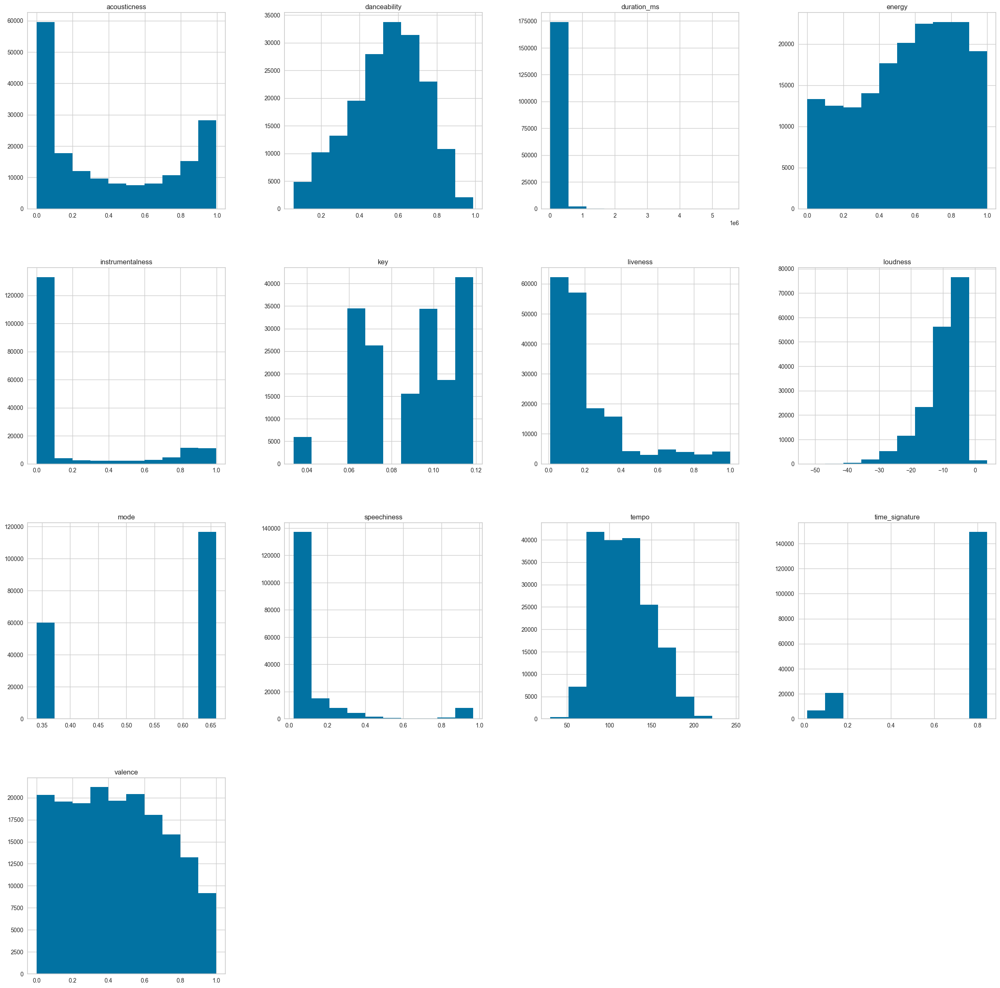

In [7]:
#5) Mirar histograma
df5.hist(figsize=(30, 30)), 

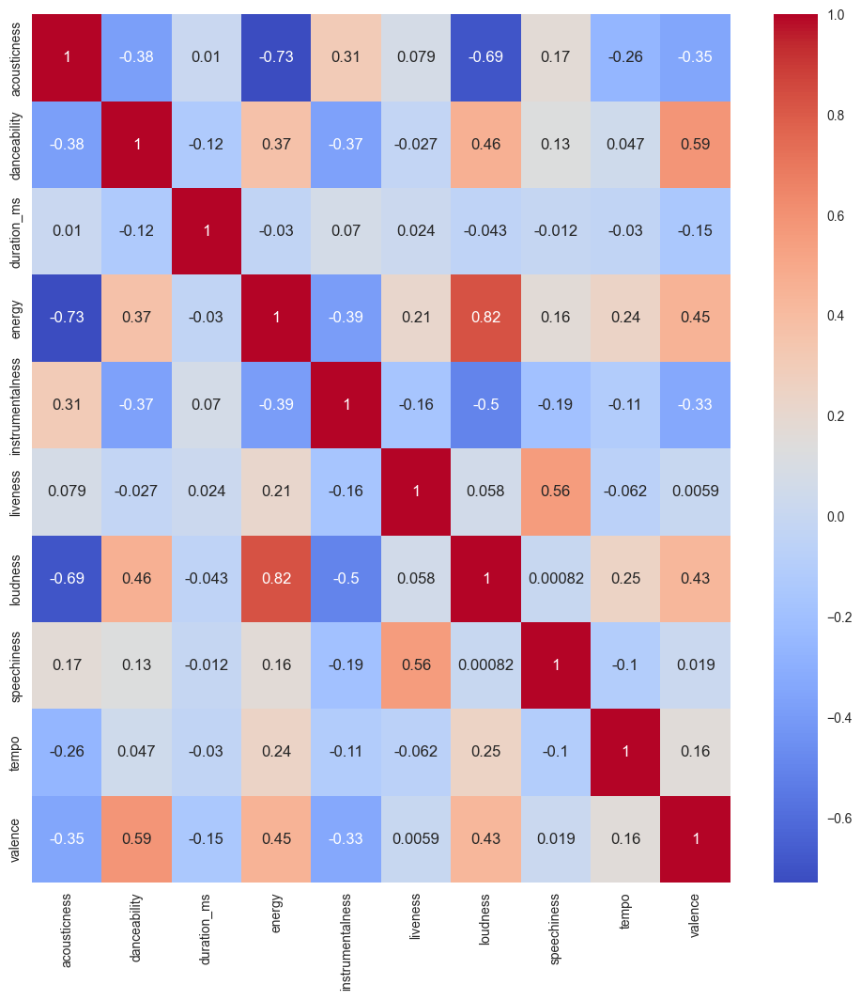

In [8]:
#6) Mirar correlació (pearson)
corr_matrix3 = df5[num_col].corr()
plt.figure(figsize=(12, 12))
ax = sns.heatmap(corr_matrix3, annot=True, cmap='coolwarm')
plt.show()

In [9]:
#7) Escalar columnes
#7) Escalar columnes
scaler = StandardScaler()
data5_scal = scaler.fit_transform(df5)

#df5_scal = pd.DataFrame(data=data5_scal, columns=df5.columns)

# D) Establir model

## 1) KMeans

Exception in thread Thread-6 (_readerthread):
Traceback (most recent call last):
  File "c:\Users\gaofu\anaconda3\Lib\threading.py", line 1038, in _bootstrap_inner
    self.run()
  File "c:\Users\gaofu\anaconda3\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "c:\Users\gaofu\anaconda3\Lib\threading.py", line 975, in run
    self._target(*self._args, **self._kwargs)
  File "c:\Users\gaofu\anaconda3\Lib\subprocess.py", line 1597, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xa2 in position 116: invalid start byte


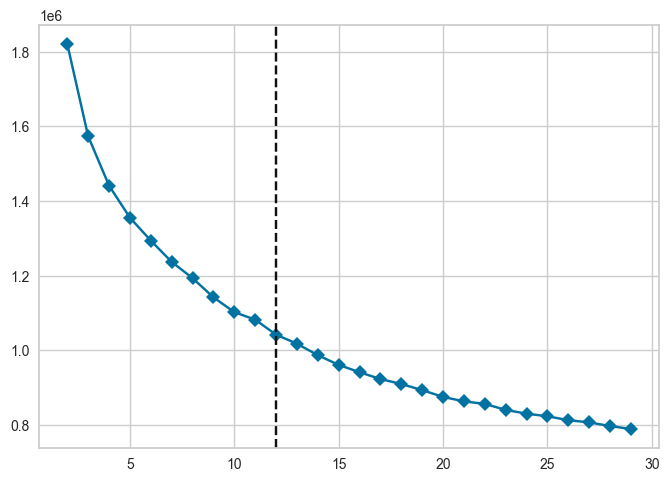

In [10]:
#DATASET3
#1) Calcular k millor
model = KMeans(n_init=10, random_state=0)
visualizer = KElbowVisualizer(model, k=(2,30), timings=False, metric='distortion') #default distance_metric: euclidean
visualizer.fit(data5_scal)       
#visualizer.show() #Quitar en py
#visualizer.show(outpath="kmeans.png") #Guardar gráfica
k = visualizer.elbow_value_ #millor k
#2) Entrenar i predir amb KMEANS
kmeans = KMeans(n_clusters=k, n_init=10, random_state=0)
#kmeans = MiniBatchKMeans(n_clusters=k, n_init=10, random_state=0)
kmeans1 = kmeans.fit_predict(data5_scal) #Mateix que: kmeans.labels__
#data_scal["cluster"] = pred

## 2) DBSCAN

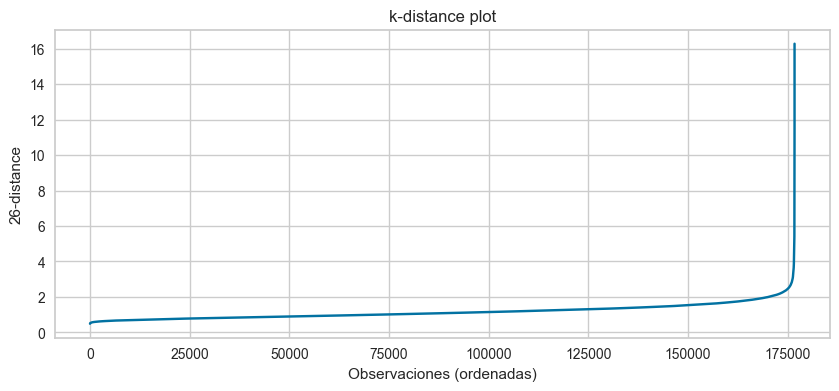

2.444454118457258


In [11]:
#DATASET3
#1) Calcular eps
min_samples = 2 * data5_scal.shape[1]
nn = NearestNeighbors(n_neighbors=min_samples).fit(data5_scal) #default algorithm: auto; most appropiate, default metric: minkowski
dists, _ = nn.kneighbors(data5_scal)
kdist = np.sort(dists[:, -1])
plt.figure(figsize=(10,4))
plt.plot(kdist, label=f'{min_samples}-distance sorted')
plt.title('k-distance plot')
plt.xlabel('Observaciones (ordenadas)')
plt.ylabel(f'{min_samples}-distance')
plt.savefig("dbscan.png")
plt.show()
print(kdist[175000])

In [12]:
#2) Entrenar i predir amb DBSCAN
min_samples = 2 * data5_scal.shape[1]
dbscan = DBSCAN(eps=2.4, min_samples=min_samples, n_jobs=-1,) #default algorithm: auto of NearestNeighbours; most appropiate
dbscan1 = dbscan.fit_predict(data5_scal)
#print(calinski_harabasz_score(data5_scal, dbscan1), davies_bouldin_score(data5_scal, dbscan1))

## 3) HDBSCAN

In [13]:
#DATASET3
#1) Entrenar i predir amb HDBSCAN
min_samples = 2 * data5_scal.shape[1]
hdbscan = HDBSCAN(min_cluster_size=min_samples, min_samples=min_samples, n_jobs=-1, store_centers="centroid") #default metric: euclidean
hdbscan1 = hdbscan.fit_predict(data5_scal)

## 4) Gaussian Mixture

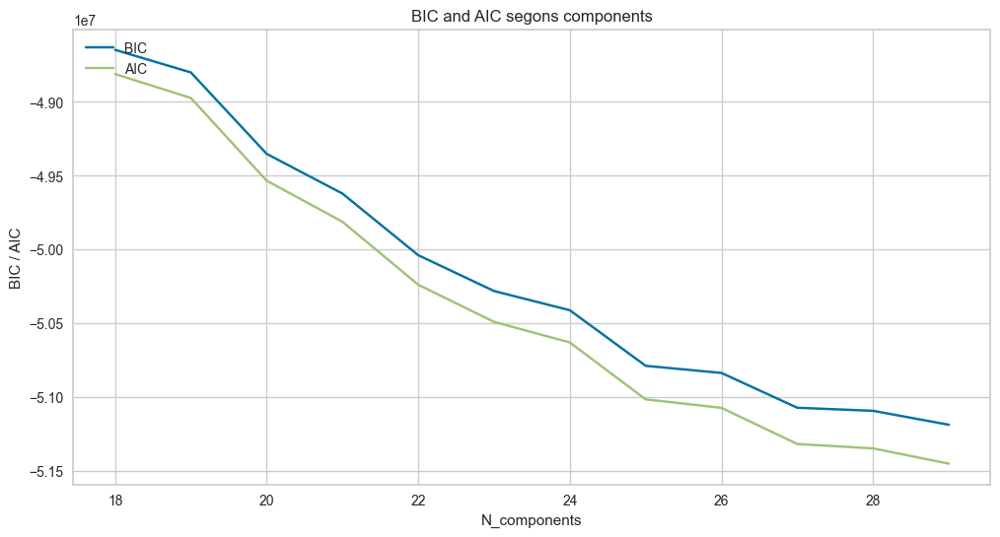

In [ ]:
#DATASET3
#1) Trobar n_components
n_components_range = range(18, 30)
bics = []
aics = []

for n in n_components_range:
    gmm = GaussianMixture(n_components=n, n_init=10, random_state=0)
    gmm.fit(data5_scal)
    bics.append(gmm.bic(data5_scal))
    aics.append(gmm.aic(data5_scal))

plt.figure(figsize=(12, 6))
plt.plot(n_components_range, bics, label='BIC')
plt.plot(n_components_range, aics, label='AIC')
plt.xlabel('N_components')
plt.ylabel('BIC / AIC')
plt.legend(loc=2)
plt.title('BIC and AIC segons components')
plt.savefig("gm.png")
plt.show()

In [ ]:
#DATASET3
#2) Entrenar i predir amb GM
gm = GaussianMixture(n_components=25, n_init=10, random_state=0) #default covariance_type: full 
gm1 = gm.fit_predict(data5_scal)

# E) Evaluar models

In [14]:
#KMEANS
print(calinski_harabasz_score(data5_scal, kmeans1), davies_bouldin_score(data5_scal, kmeans1))

19373.935922831573 1.8054381946404519


In [15]:
#DBSCAN
print(calinski_harabasz_score(data5_scal, dbscan1), davies_bouldin_score(data5_scal, dbscan1))

13774.446508342506 1.7251464916689372


In [16]:
#HDBSCAN
print(calinski_harabasz_score(data5_scal, hdbscan1), davies_bouldin_score(data5_scal, hdbscan1))

2011.6984512118734 2.277109215713191


In [ ]:
#GaussianMixture
print(calinski_harabasz_score(data5_scal, gm1), davies_bouldin_score(data5_scal, gm1))

21364.7696365001 0.8837005835017352


In [17]:
#len(set(kmeans1)), len(set(dbscan1)), len(set(hdbscan1)), len(set(gm1))
len(set(kmeans1)), len(set(dbscan1)), len(set(hdbscan1))

(12, 3, 3)

# F) Visualitzar clústers

In [18]:
# Crear sampled dataset per proves més ràpides
# Samplearem 15% de les dades per a proves
sample_size = int(len(df) * 0.15)
#sample_size = int(len(df) * 0.15 / len(set(hdbscan1)))

#df5_kmeans1 = pd.DataFrame(data=data5_scal, columns=df5.columns)
#df5_kmeans1["label"] = hdbscan1
#sample_indices = df5_kmeans1.groupby("label").apply(lambda x: x.sample(sample_size, random_state=0) if len(x) >= sample_size else x, include_groups=False).droplevel("label").index
sample_indices = np.random.RandomState(42).choice(len(df), sample_size, replace=False)

df5_sample = data5_scal[sample_indices]
#pred= pred[sample_indices]
print("Mida orignal:", df.shape)
print("Mida 20%:", df5_sample.shape)

Mida orignal: (176767, 13)
Mida 20%: (26515, 13)


## 1) HDBSCAN

In [19]:
# 1. PCA Estàndard
pca_sample = PCA(n_components=2, random_state=42)
df5_sample_pca = pca_sample.fit_transform(df5_sample)

df5_sample_pca_2 = pd.DataFrame(data=df5_sample_pca, columns=['Component 1', 'Component 2'])
df5_sample_pca_2["kmeans"] = kmeans1[sample_indices]
df5_sample_pca_2["dbscan"] = dbscan1[sample_indices]
df5_sample_pca_2["hdbscan"] = hdbscan1[sample_indices]

# 2. KernelPCA RBF
kpca_sample = KernelPCA(n_components=2, kernel='rbf', random_state=42, n_jobs=-1)
df5_sample_kpca = kpca_sample.fit_transform(df5_sample)

df5_sample_kpca_2 = pd.DataFrame(data=df5_sample_kpca, columns=['Component 1', 'Component 2'])
df5_sample_kpca_2["kmeans"] = kmeans1[sample_indices]
df5_sample_kpca_2["dbscan"] = dbscan1[sample_indices]
df5_sample_kpca_2["hdbscan"] = hdbscan1[sample_indices]

# 3. TruncatedSVD
tsvd_sample = TruncatedSVD(n_components=2, random_state=42)
df5_sample_tsvd = tsvd_sample.fit_transform(df5_sample)

df5_sample_tsvd_2 = pd.DataFrame(data=df5_sample_tsvd, columns=['Component 1', 'Component 2'])
df5_sample_tsvd_2["kmeans"] = kmeans1[sample_indices]
df5_sample_tsvd_2["dbscan"] = dbscan1[sample_indices]
df5_sample_tsvd_2["hdbscan"] = hdbscan1[sample_indices]

# 4. TSNE
tsne = TSNE(n_components=2, perplexity=150, learning_rate='auto', random_state=42)
df5_sample_tsne = tsne.fit_transform(df5_sample)
df5_sample_tsne_2 = pd.DataFrame(data=df5_sample_tsne, columns=['Component 1', 'Component 2'])
df5_sample_tsne_2["kmeans"] = kmeans1[sample_indices]
df5_sample_tsne_2["dbscan"] = dbscan1[sample_indices]
df5_sample_tsne_2["hdbscan"] = hdbscan1[sample_indices]

In [20]:
pca_sample.explained_variance_ratio_.cumsum(), tsvd_sample.explained_variance_ratio_.cumsum(), tsne.kl_divergence_

(array([0.28265377, 0.42261777]),
 array([0.28265377, 0.42261777]),
 1.7507305145263672)

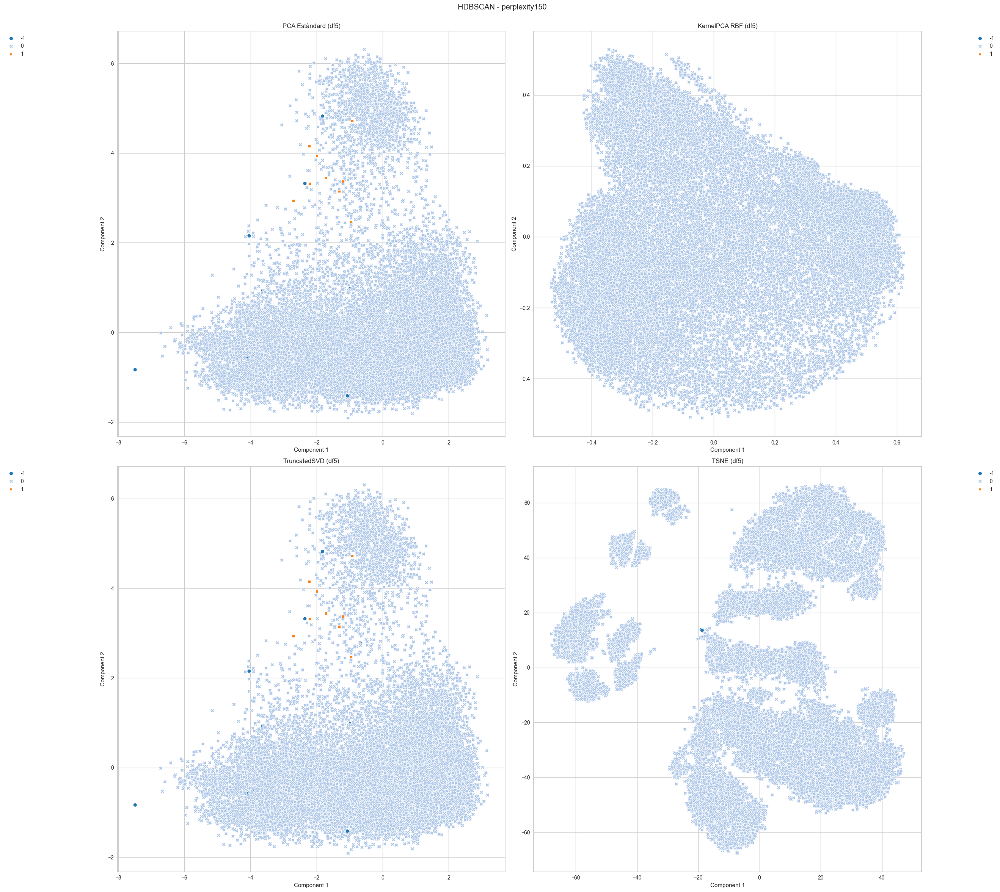

In [21]:
#HDBSCAN
fig, axes = plt.subplots(2, 2, figsize=(26, 24))

# 1. PCA Estàndard
#df5_sample_pca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_pca_2, x='Component 1', y='Component 2', hue='hdbscan', style='hdbscan',
               palette='tab20', ax=axes[0, 0])
axes[0, 0].set_title('PCA Estàndard (df5)')
axes[0, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 2. KernelPCA RBF
#df5_sample_kpca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_kpca_2, x='Component 1', y='Component 2', hue='hdbscan',  style='hdbscan',
               palette='tab20', ax=axes[0, 1])
axes[0, 1].set_title('KernelPCA RBF (df5)')
axes[0, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

# 3. TruncatedSVD
#df5_sample_tsvd_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_tsvd_2, x='Component 1', y='Component 2', hue='hdbscan',  style='hdbscan',
               palette='tab20', ax=axes[1, 0])
axes[1, 0].set_title('TruncatedSVD (df5)')
axes[1, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 4. TSNE
#df5_sample_tsne_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_tsne_2, x='Component 1', y='Component 2', hue='hdbscan', style='hdbscan',
               palette='tab20', ax=axes[1, 1])
axes[1, 1].set_title('TSNE (df5)')
axes[1, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

plt.tight_layout()
plt.suptitle(f"HDBSCAN - perplexity{tsne.perplexity}")
fig.subplots_adjust(top=0.95)
plt.legend(loc=1, bbox_to_anchor=(1.2, 1))
plt.show()

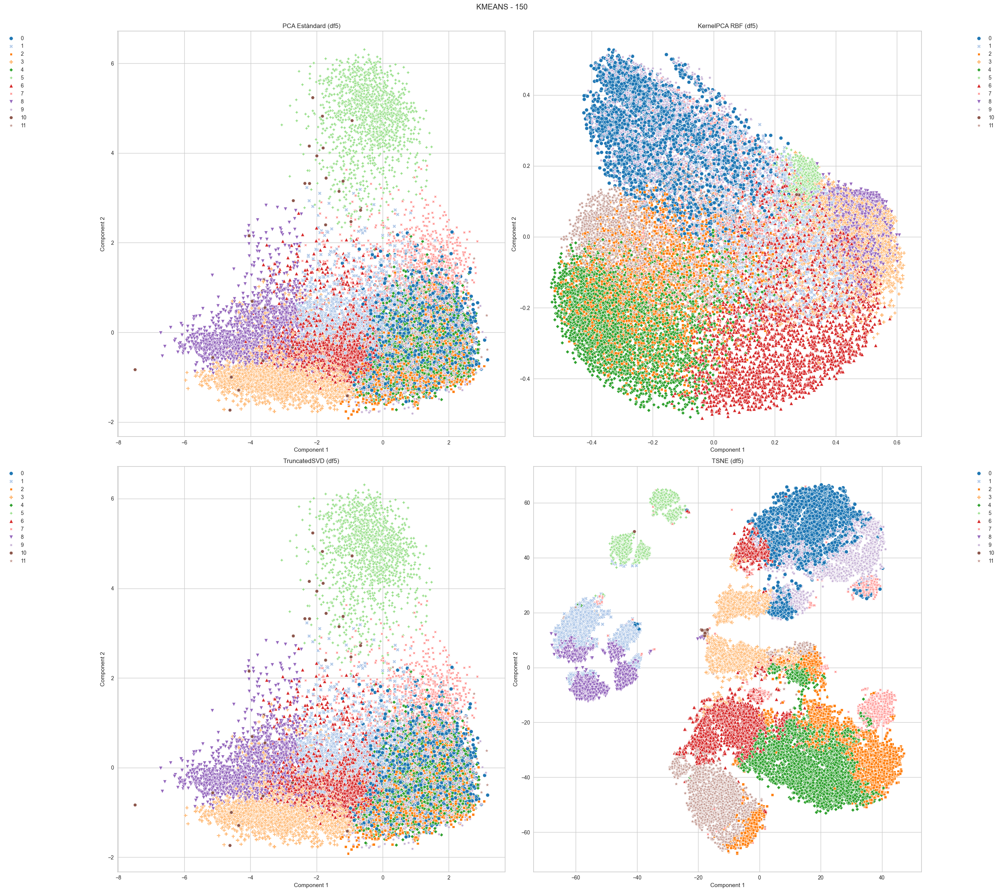

In [22]:
#KMEANS
fig, axes = plt.subplots(2, 2, figsize=(26, 24))

# 1. PCA Estàndard
#df5_sample_pca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_pca_2, x='Component 1', y='Component 2', hue='kmeans', style='kmeans',
               palette='tab20', ax=axes[0, 0])
axes[0, 0].set_title('PCA Estàndard (df5)')
axes[0, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 2. KernelPCA RBF
#df5_sample_kpca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_kpca_2, x='Component 1', y='Component 2', hue='kmeans',  style='kmeans',
               palette='tab20', ax=axes[0, 1])
axes[0, 1].set_title('KernelPCA RBF (df5)')
axes[0, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

# 3. TruncatedSVD
#df5_sample_tsvd_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_tsvd_2, x='Component 1', y='Component 2', hue='kmeans',  style='kmeans',
               palette='tab20', ax=axes[1, 0])
axes[1, 0].set_title('TruncatedSVD (df5)')
axes[1, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 4. TSNE
#df5_sample_tsne_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_tsne_2, x='Component 1', y='Component 2', hue='kmeans', style='kmeans',
               palette='tab20', ax=axes[1, 1])
axes[1, 1].set_title('TSNE (df5)')
axes[1, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

plt.tight_layout()
plt.suptitle(f"KMEANS - {tsne.perplexity}")
fig.subplots_adjust(top=0.95)
plt.legend(loc=1, bbox_to_anchor=(1.2, 1))
plt.show()

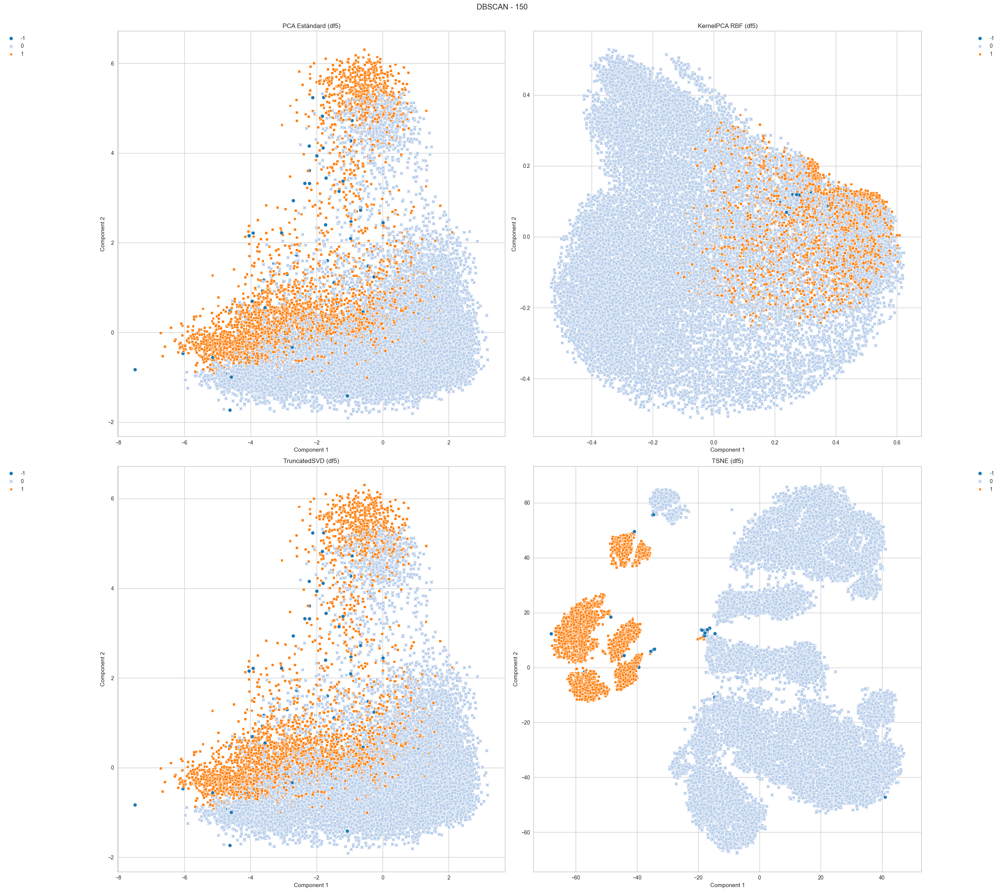

In [23]:
#DBSCAN
fig, axes = plt.subplots(2, 2, figsize=(26, 24))

# 1. PCA Estàndard
#df5_sample_pca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_pca_2, x='Component 1', y='Component 2', hue='dbscan', style='dbscan',
               palette='tab20', ax=axes[0, 0])
axes[0, 0].set_title('PCA Estàndard (df5)')
axes[0, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 2. KernelPCA RBF
#df5_sample_kpca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_kpca_2, x='Component 1', y='Component 2', hue='dbscan',  style='dbscan',
               palette='tab20', ax=axes[0, 1])
axes[0, 1].set_title('KernelPCA RBF (df5)')
axes[0, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

# 3. TruncatedSVD
#df5_sample_tsvd_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_tsvd_2, x='Component 1', y='Component 2', hue='dbscan',  style='dbscan',
               palette='tab20', ax=axes[1, 0])
axes[1, 0].set_title('TruncatedSVD (df5)')
axes[1, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 4. TSNE
#df5_sample_tsne_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_tsne_2, x='Component 1', y='Component 2', hue='dbscan', style='dbscan',
               palette='tab20', ax=axes[1, 1])
axes[1, 1].set_title('TSNE (df5)')
axes[1, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

plt.tight_layout()
plt.suptitle(f"DBSCAN - {tsne.perplexity}")
fig.subplots_adjust(top=0.95)
plt.legend(loc=1, bbox_to_anchor=(1.2, 1))
plt.show()

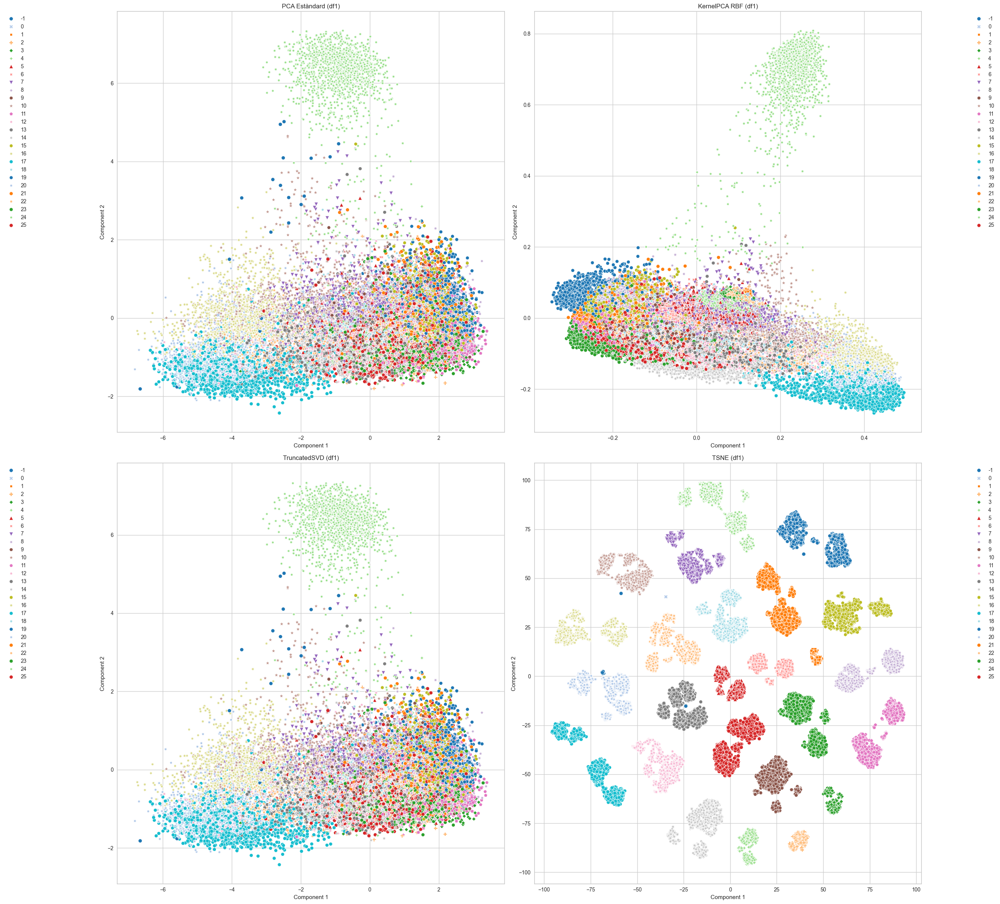

In [ ]:
#BASE NO EJECUTAR
fig, axes = plt.subplots(2, 2, figsize=(26, 24))

# 1. PCA Estàndard
pca_sample = PCA(n_components=2, random_state=42)
df5_sample_pca = pca_sample.fit_transform(df5_sample)

df5_sample_pca_2 = pd.DataFrame(data=df5_sample_pca, columns=['Component 1', 'Component 2'])
df5_sample_pca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_pca_2, x='Component 1', y='Component 2', hue='Cluster', style='Cluster',
               palette='tab20', ax=axes[0, 0])
axes[0, 0].set_title('PCA Estàndard (df5)')
axes[0, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 2. KernelPCA RBF
kpca_sample = KernelPCA(n_components=2, kernel='rbf', random_state=42, n_jobs=-1)
df5_sample_kpca = kpca_sample.fit_transform(df5_sample)

df5_sample_kpca_2 = pd.DataFrame(data=df5_sample_kpca, columns=['Component 1', 'Component 2'])
df5_sample_kpca_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_kpca_2, x='Component 1', y='Component 2', hue='Cluster',  style='Cluster',
               palette='tab20', ax=axes[0, 1])
axes[0, 1].set_title('KernelPCA RBF (df5)')
axes[0, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

# 3. TruncatedSVD
tsvd_sample = TruncatedSVD(n_components=2, random_state=42)
df5_sample_tsvd = tsvd_sample.fit_transform(df5_sample)

df5_sample_tsvd_2 = pd.DataFrame(data=df5_sample_tsvd, columns=['Component 1', 'Component 2'])
df5_sample_tsvd_2["Cluster"] = hdbscan1[sample_indices]
sns.scatterplot(data=df5_sample_tsvd_2, x='Component 1', y='Component 2', hue='Cluster',  style='Cluster',
               palette='tab20', ax=axes[1, 0])
axes[1, 0].set_title('TruncatedSVD (df5)')
axes[1, 0].legend(loc=2, bbox_to_anchor=(-0.3, 1))

# 4. TSNE
tsne = TSNE(n_components=2, perplexity=50, learning_rate='auto', random_state=42)
df5_sample_tsne = tsne.fit_transform(df5_sample)
df5_sample_tsne_2 = pd.DataFrame(data=df5_sample_tsne, columns=['Component 1', 'Component 2'])
df5_sample_tsne_2["Cluster"] = hdbscan1[sample_indices]

sns.scatterplot(data=df5_sample_tsne_2, x='Component 1', y='Component 2', hue='Cluster', style='Cluster',
               palette='tab20', ax=axes[1, 1])
axes[1, 1].set_title('TSNE (df5)')
axes[1, 1].legend(loc=1, bbox_to_anchor=(1.2, 1))

plt.tight_layout()
plt.legend(loc=1, bbox_to_anchor=(1.2, 1))
plt.show()

# H) Anàlisi

<Axes: ylabel='label'>

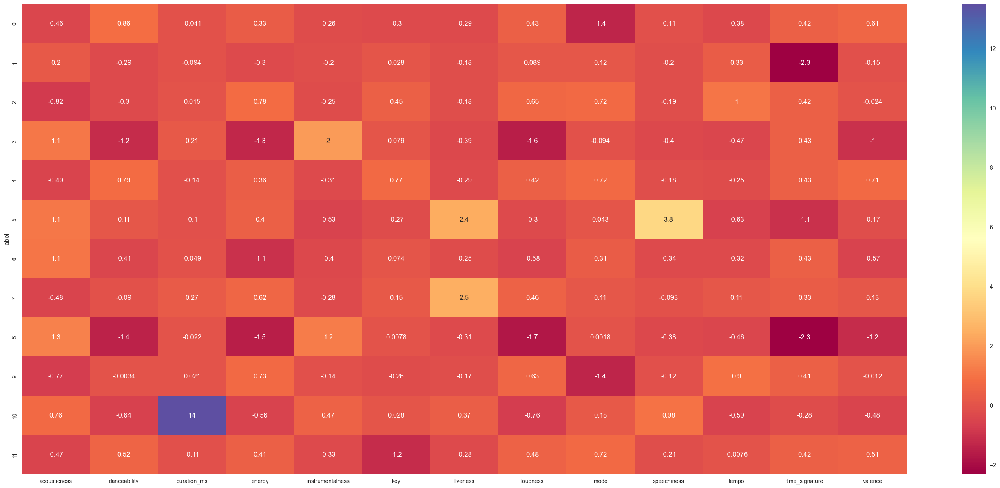

In [24]:
df5_kmeans1 = pd.DataFrame(data=data5_scal, columns=df5.columns)
df5_kmeans1["label"] = kmeans1

tmp = df5_kmeans1.groupby(by=["label"]).mean()

plt.figure(figsize=(35, 15))
sns.heatmap(tmp, cmap="Spectral", annot=True)

C:\Users\gaofu\AppData\Local\Temp\ipykernel_10056\3393985219.py:4: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df5_kmeans1, x=c, hue="label", ax=axes[i])
C:\Users\gaofu\AppData\Local\Temp\ipykernel_10056\3393985219.py:4: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df5_kmeans1, x=c, hue="label", ax=axes[i])
C:\Users\gaofu\AppData\Local\Temp\ipykernel_10056\3393985219.py:4: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(df5_kmeans1, x=c, hue="label", ax=axes[i])


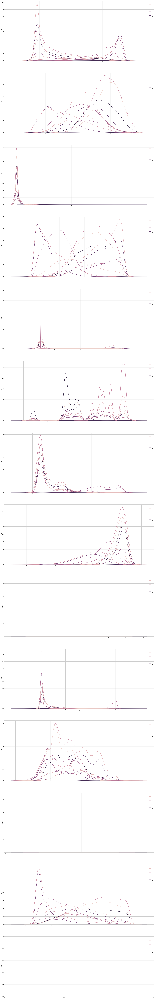

In [25]:
fig, axes = plt.subplots(len(df5_kmeans1.columns), figsize=(30, 200))

for i, c in enumerate(df5_kmeans1.columns): 
    sns.kdeplot(df5_kmeans1, x=c, hue="label", ax=axes[i])

plt.show()

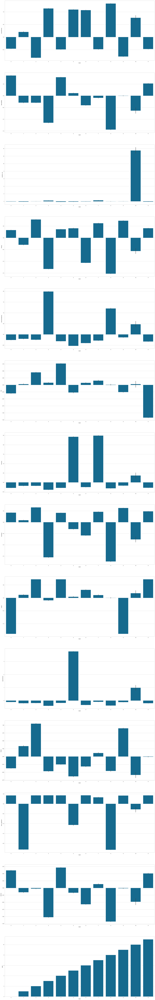

In [26]:
fig, axes = plt.subplots(len(df5_kmeans1.columns), figsize=(30, 200))

for i, c in enumerate(df5_kmeans1.columns): 
    sns.barplot(df5_kmeans1, y=c, x="label", ax=axes[i])

plt.show()

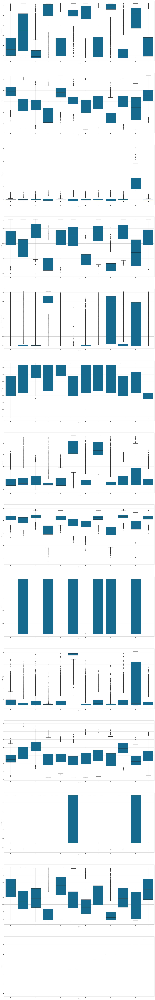

In [27]:
fig, axes = plt.subplots(len(df5_kmeans1.columns), figsize=(30, 200))

for i, c in enumerate(df5_kmeans1.columns): 
    sns.boxplot(df5_kmeans1, x="label", y=c, ax=axes[i])

plt.show()

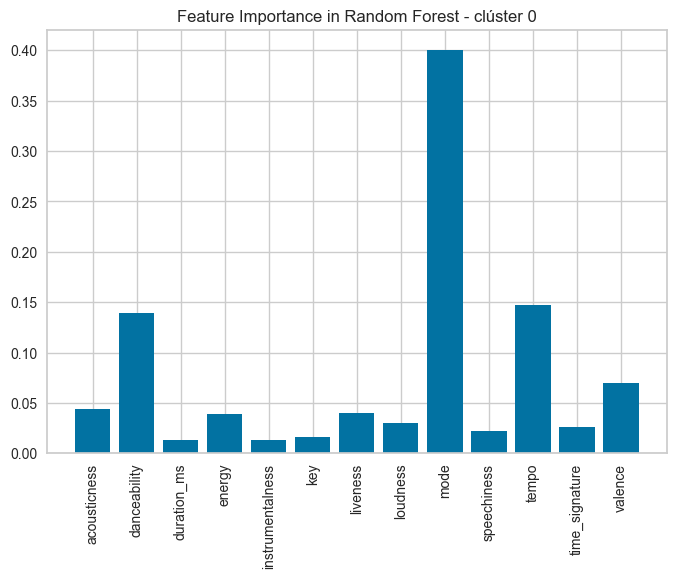

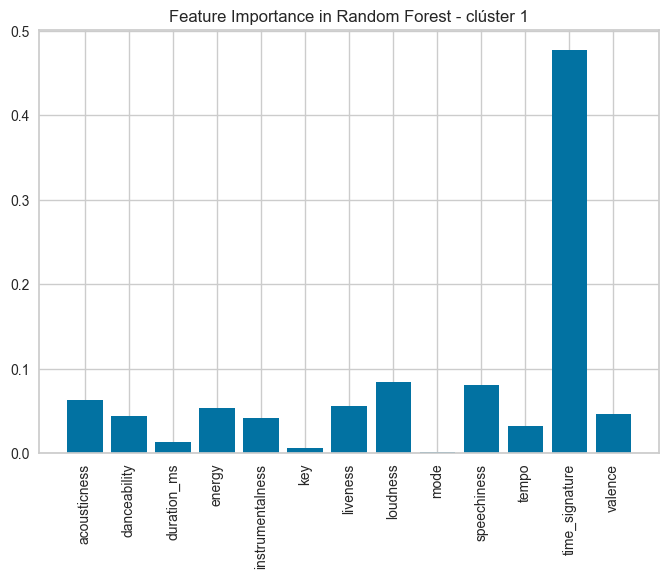

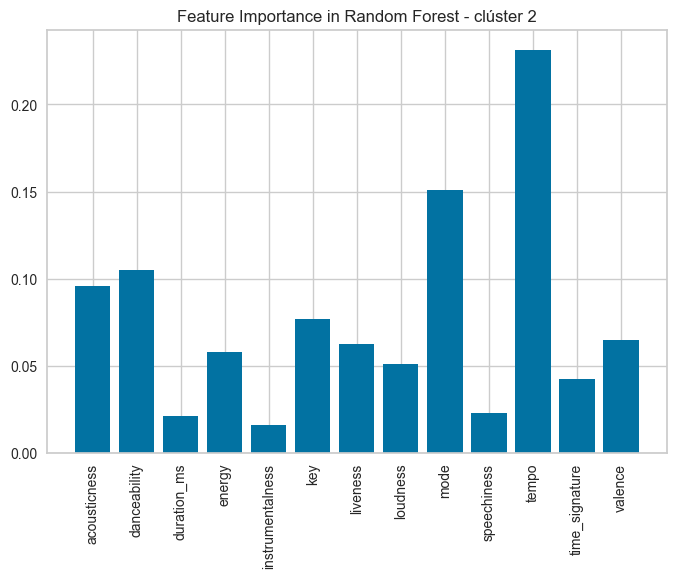

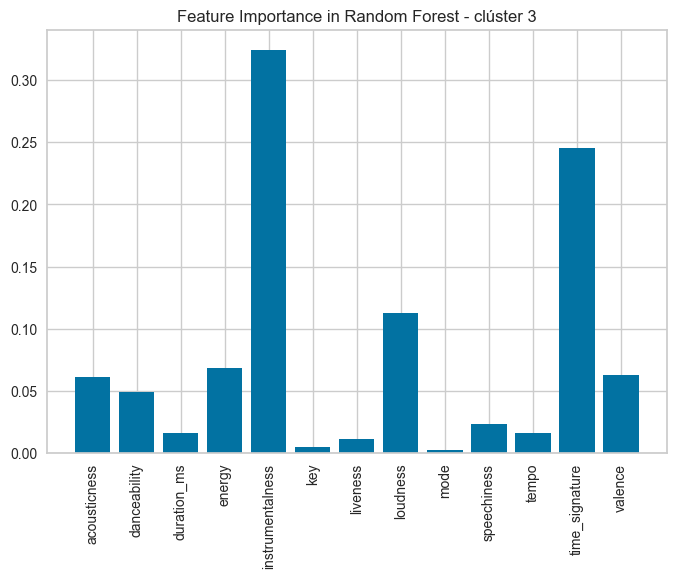

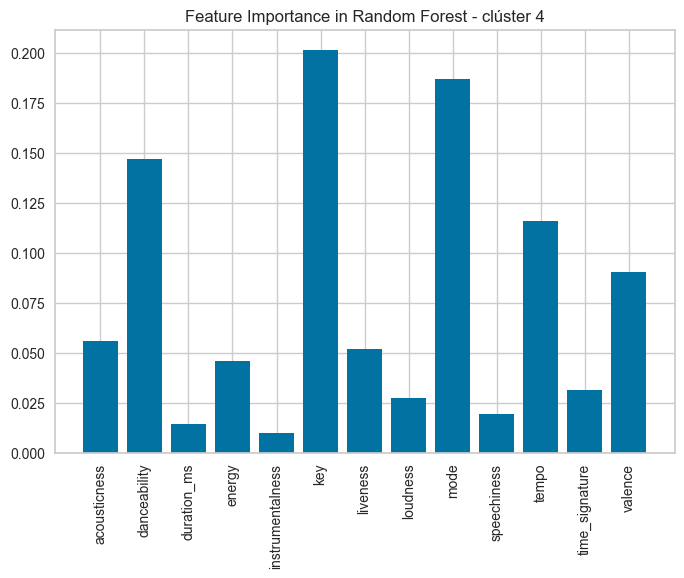

...

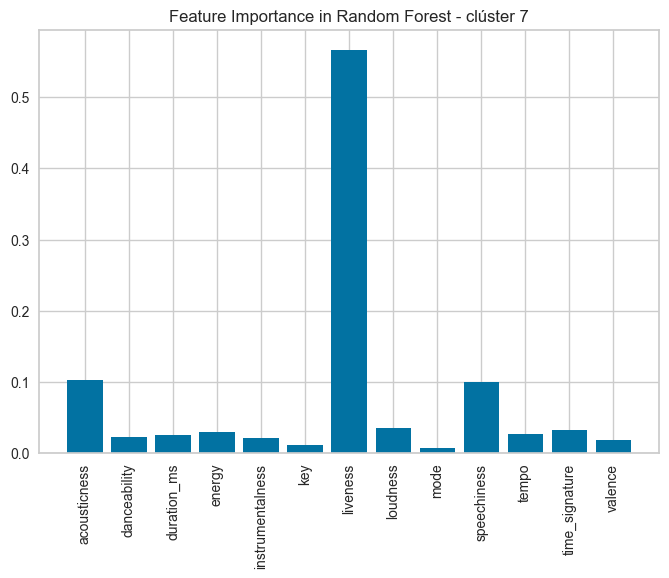

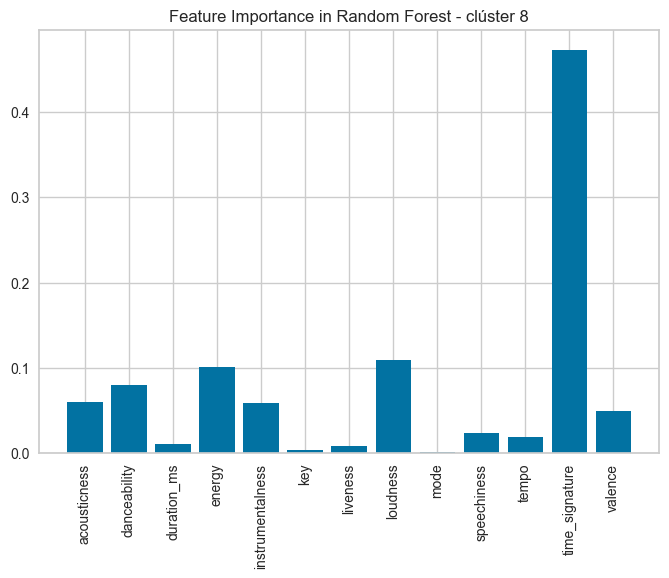

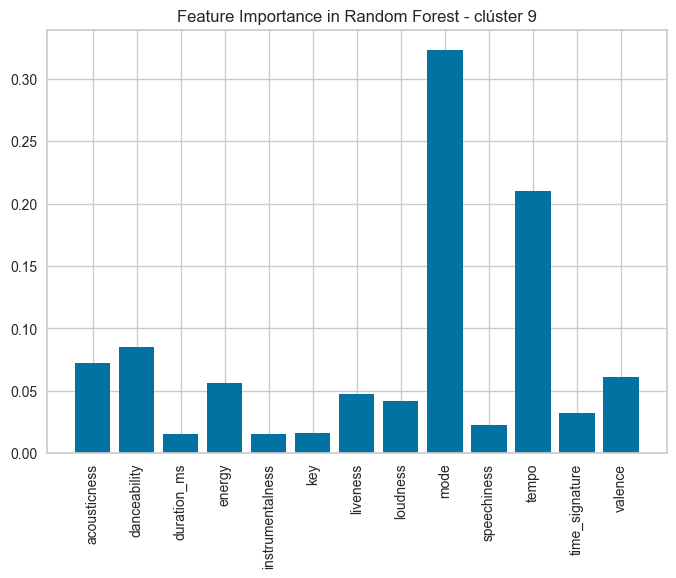

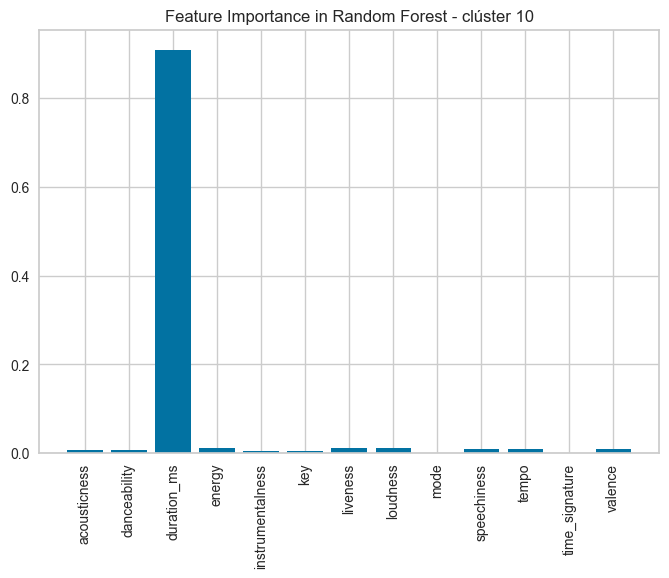

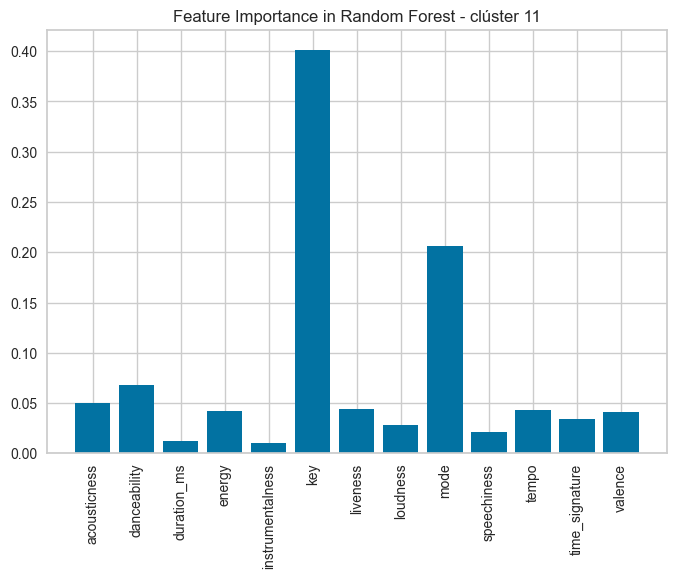

In [28]:
from sklearn.ensemble import RandomForestClassifier


for i in range(len(set(kmeans1))):
    df5_kmeans1["cluster_"+str(i)] = (df5_kmeans1["label"] == i)

    clf = RandomForestClassifier(random_state=1)
    clf.fit(df5_kmeans1.iloc[:, 0:13].values, df5_kmeans1["cluster_"+str(i)].values)

    importance = clf.feature_importances_
    #plt.bar(range(num.shape[1]), importance)
    plt.bar(range(13), importance)
    plt.xticks(range(13), df5_kmeans1.columns[0:13], rotation=90)
    plt.title("Feature Importance in Random Forest - clúster " + str(i))
    plt.show()

In [29]:
pd.DataFrame(data=scaler.inverse_transform(tmp), columns=df.columns)

,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence
0,0.235229,0.704912,2.307786e+05,0.647154,0.088728,0.083555,0.163217,-7.418425,0.340301,0.105156,105.456125,0.841763,0.615962
1,0.478412,0.484996,2.238643e+05,0.475349,0.106252,0.090806,0.186337,-9.567257,0.568653,0.085613,127.633318,0.097079,0.411113
2,0.103645,0.484736,2.380581e+05,0.771629,0.092323,0.099984,0.186220,-5.952732,0.659699,0.088552,150.016423,0.842643,0.445167
3,0.819865,0.321791,2.637010e+05,0.191043,0.813064,0.091904,0.142430,-20.067009,0.536725,0.045268,102.557035,0.843970,0.177088
4,0.224995,0.691201,2.175838e+05,0.657267,0.070418,0.106922,0.163487,-7.477984,0.659699,0.091061,109.359161,0.842933,0.642775
5,0.804374,0.562290,2.224963e+05,0.668727,0.000433,0.084277,0.736271,-12.075081,0.557572,0.898242,97.397746,0.435621,0.406973
6,0.795699,0.463517,2.297440e+05,0.263446,0.042580,0.091796,0.171790,-13.878116,0.597943,0.058490,107.285538,0.843970,0.298366
7,0.227880,0.523923,2.708730e+05,0.727803,0.080301,0.093521,0.749941,-7.179392,0.567140,0.108392,120.705802,0.816132,0.487460
8,0.891214,0.266424,2.332338e+05,0.135571,0.559990,0.090355,0.158305,-21.237476,0.551287,0.049388,102.837126,0.093594,0.136678
9,0.121504,0.540435,2.388527e+05,0.757355,0.127261,0.084571,0.188324,-6.112187,0.340301,0.103298,145.339932,0.839689,0.448299


# Random songs

In [30]:
cluster_labels = sorted([label for label in set(kmeans1) if label != -1]) #totes les labels del model
sizes = {label: int((kmeans1 == label).sum()) for label in cluster_labels} #quanitat de cancos en cada label

random_index = np.random.RandomState(42).randint(len(data5_scal)) #index de canço random
random_label = kmeans1[random_index] #label de canço random

cluster_index = np.where(kmeans1 == random_label)[0] #index de cancons amb label de canço random 

recomancio = 2
random_recomancio_index = np.random.RandomState(42).choice(cluster_index, size=recomancio, replace=False) #index de 

#print("Nom canço:", canciones.loc[:, "track_name"][random_index].values)
#print("Nom artista:", canciones.loc[:, "artist_name"][random_index].values)
print("Nom canço:", canciones["track_name"][random_index])
print("Nom artista:", canciones["artist_name"][random_index])
print("Label:", kmeans1[random_index])
print("Cançons disponibles:", sizes[random_label])
print("Info:", df.iloc[random_index])

for i in range(recomancio): 
    print("RECOMANCIO", i)
    print("Nom canço:", canciones["track_name"][random_recomancio_index[i]])
    print("Nom artista:", canciones["artist_name"][random_recomancio_index[i]])
    print("Label:", kmeans1[random_recomancio_index[i]])
    print("Info:", df.iloc[random_recomancio_index[i]])

Nom canço: Donde Esta Mi Gata
Nom artista: Yandel
Label: 4
Cançons disponibles: 27423
Info: acousticness           0.113
danceability            0.79
duration_ms           164347
energy                 0.808
instrumentalness    0.000009
key                        D
liveness               0.222
loudness              -5.194
mode                   Major
speechiness           0.0522
tempo                 96.005
time_signature           4/4
valence                0.677
Name: 121958, dtype: object
RECOMANCIO 0
Nom canço: Mi Forma De Tiraera
Nom artista: Vico C
Label: 4
Info: acousticness         0.532
danceability          0.83
duration_ms         328160
energy               0.714
instrumentalness       0.0
key                      G
liveness             0.105
loudness            -1.939
mode                 Major
speechiness          0.263
tempo               94.082
time_signature         4/4
valence              0.853
Name: 120391, dtype: object
RECOMANCIO 1
Nom canço: Worthy Of Your Name -